#**🚨 Before Running the Script, Please make sure that you have selected the Run Time as GPU**

#**Step 01: Install the Required Packages**

In [ ]:
%%capture
!pip install super-gradients==3.1.0
!pip install imutils
!pip install roboflow
!pip install pytube --upgrade

In [ ]:
!pip install torchinfo

#**🚨Restart the Run Time**

#**Step 02: Import the Required Libraries**

In [ ]:
!pip install super-gradients
from super_gradients.training import models


The console stream is logged into /root/sg_logs/console.log


[2024-01-12 04:06:53] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2024-01-12 04:06:53] WARNING - __init__.py - Failed to import pytorch_quantization
[2024-01-12 04:06:54] INFO - utils.py - NumExpr defaulting to 2 threads.
[2024-01-12 04:07:00] WARNING - calibrator.py - Failed to import pytorch_quantization
[2024-01-12 04:07:00] WARNING - export.py - Failed to import pytorch_quantization
[2024-01-12 04:07:00] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization


In [ ]:
from torchinfo import summary

#**Step 03: Instantiating a Pretrained Model**

In [ ]:
yolo_nas_l = models.get("yolo_nas_l", pretrained_weights="coco")

[2024-01-12 04:07:09] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
[2024-01-12 04:07:10] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_l


#**Step 04: Model Architecture**

In [ ]:
summary(model=yolo_nas_l,
        input_size=(16, 3, 640, 640),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                                           Input Shape          Output Shape         Param #              Trainable
YoloNAS_L (YoloNAS_L)                                             [16, 3, 640, 640]    [16, 8400, 4]        --                   True
├─NStageBackbone (backbone)                                       [16, 3, 640, 640]    [16, 96, 160, 160]   --                   True
│    └─YoloNASStem (stem)                                         [16, 3, 640, 640]    [16, 48, 320, 320]   --                   True
│    │    └─QARepVGGBlock (conv)                                  [16, 3, 640, 640]    [16, 48, 320, 320]   3,024                True
│    └─YoloNASStage (stage1)                                      [16, 48, 320, 320]   [16, 96, 160, 160]   --                   True
│    │    └─QARepVGGBlock (downsample)                            [16, 48, 320, 320]   [16, 96, 160, 160]   88,128               True
│    │    └─YoloNASCSPLayer (blocks)                     

#**Step 05: Inference with YOLONAS**

#**🖼️ Inference on an image**

#**A path to image file**

[2024-01-12 04:07:24] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


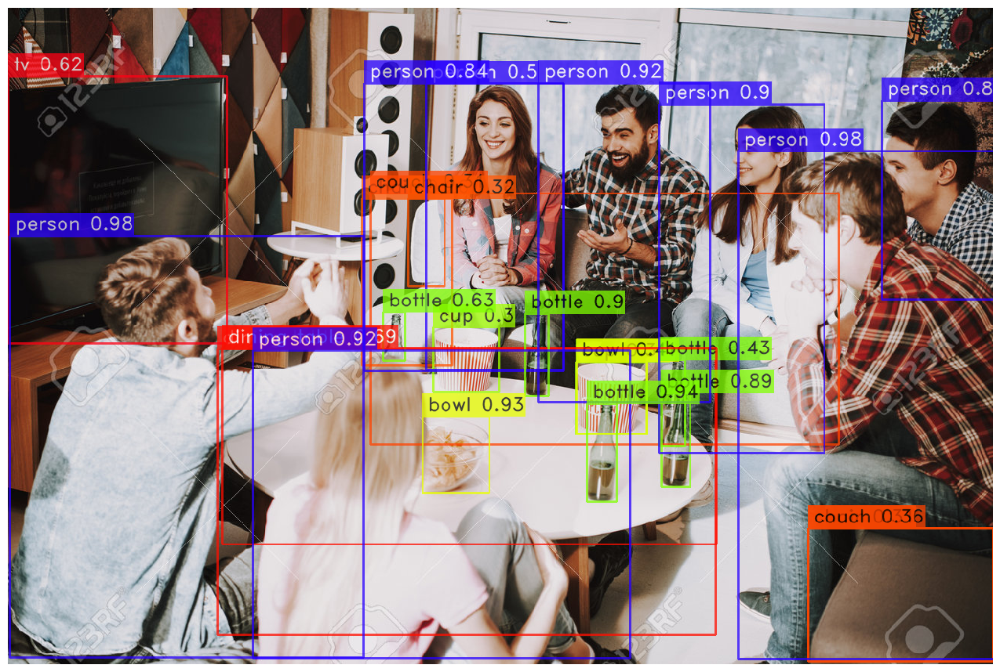

In [ ]:
url = "https://previews.123rf.com/images/freeograph/freeograph2011/freeograph201100150/158301822-group-of-friends-gathering-around-table-at-home.jpg"
yolo_nas_l.predict(url, conf=0.25).show()

#**Upload an Image**

In [ ]:
!gdown "https://drive.google.com/uc?id=1q-sNrJfUi6PjvT8mFfEw1Cq4eCavdklK&confirm=t"

Traceback (most recent call last):
  File "/usr/local/bin/gdown", line 8, in <module>
    sys.exit(main())
  File "/usr/local/lib/python3.10/dist-packages/gdown/cli.py", line 151, in main
    filename = download(
  File "/usr/local/lib/python3.10/dist-packages/gdown/download.py", line 203, in download
    filename_from_url = m.groups()[0]
AttributeError: 'NoneType' object has no attribute 'groups'


[2024-01-12 04:07:40] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


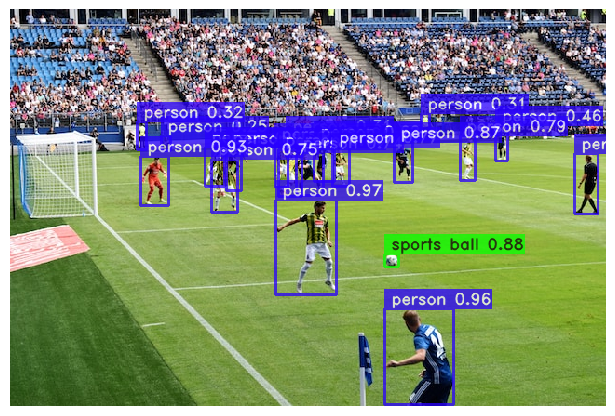

In [ ]:
image_path = '/content/drive/MyDrive/Udemy YOLO 7   8/10. YOLO-NAS Object Detection  Run YOLO-NAS in 1 CLICK - Google Colab/waldemar-PhhtSyCeN0I-unsplash.jpg'
yolo_nas_l.predict(image_path, conf=0.25).show()

[2024-01-12 04:07:47] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


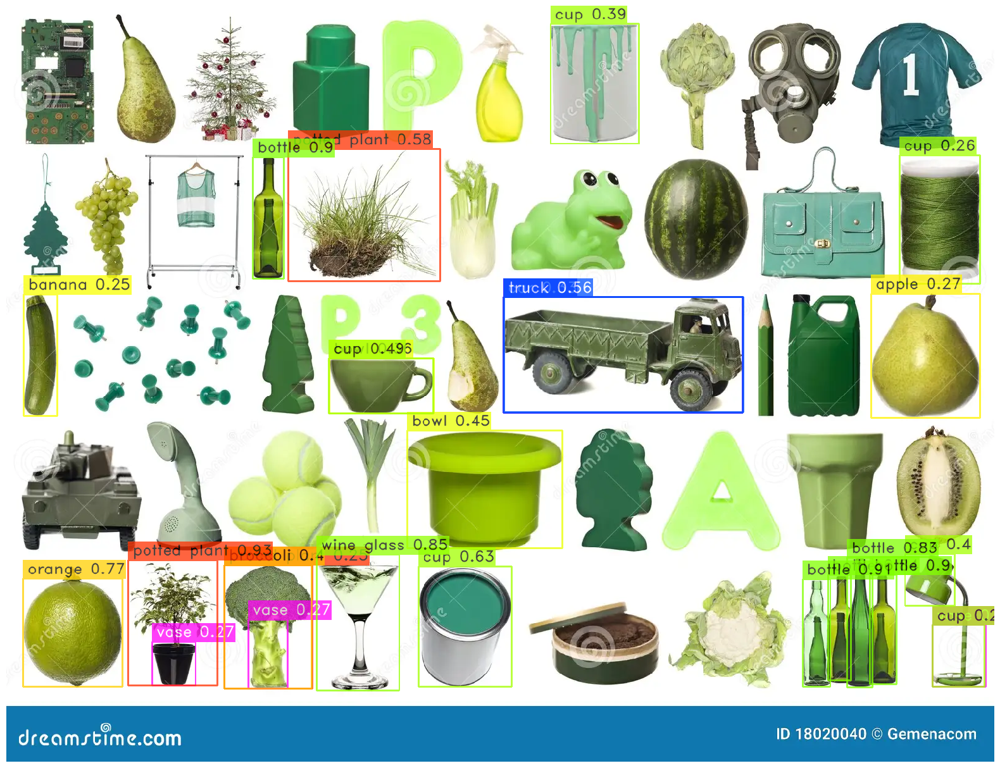

In [ ]:
image_path = '/content/drive/MyDrive/Udemy YOLO 7   8/10. YOLO-NAS Object Detection  Run YOLO-NAS in 1 CLICK - Google Colab/group-green-objects-18020040.webp'
yolo_nas_l.predict(image_path, conf=0.25).show()

#**🎥 Inference on Video 1**

In [ ]:
!gdown "https://drive.google.com/uc?id=1hl_NNFciFwImmqplL3RkozpiIa8I38cd&confirm=t"

In [ ]:
input_video_path = f"/content/drive/MyDrive/Udemy YOLO 7   8/10. YOLO-NAS Object Detection  Run YOLO-NAS in 1 CLICK - Google Colab/10.37sec _ 100m _ Srilanka Season Opening _ New P.R. 💯🇱🇰 #100m #running #athlete #technique #shorts.mp4"
output_video_path = "detections.mp4"

In [ ]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [ ]:
yolo_nas_l.to(device).predict(input_video_path).save(output_video_path)

Processing Video: 100%|██████████| 712/712 [00:25<00:00, 28.25it/s]


#**Display the Output Video**

In [ ]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**🎥 Inference on Video 2**

In [ ]:
input_video_path = f"/content/drive/MyDrive/Udemy YOLO 7   8/10. YOLO-NAS Object Detection  Run YOLO-NAS in 1 CLICK - Google Colab/100m dash_ 14.6 seconds.mp4"
output_video_path = "detections2.mp4"

In [ ]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [ ]:
yolo_nas_l.to(device).predict(input_video_path).save(output_video_path)

Processing Video:  99%|█████████▉| 1404/1414 [00:54<00:00, 35.95it/s]

#**Display the Output Video**

In [ ]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**🎥 Inference on Video 3**

In [34]:
input_video_path = f"/content/drive/MyDrive/Udemy YOLO 7   8/10. YOLO-NAS Object Detection  Run YOLO-NAS in 1 CLICK - Google Colab/Cars Moving On Road Stock Footage - Free Download.mp4"
output_video_path = "detections3.mp4"

In [35]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [36]:
yolo_nas_l.to(device).predict(input_video_path).save(output_video_path)

Processing Video: 100%|██████████| 716/716 [00:43<00:00, 16.49it/s]


In [37]:
!rm '/content/result_compressed_3.mp4'

rm: cannot remove '/content/result_compressed_3.mp4': No such file or directory


In [38]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections3.mp4'

# Compressed video path
compressed_path = "/content/result_compressed_3.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)